In [49]:
from tensorflow.keras.utils import load_img
import matplotlib.pyplot as plt
from tensorflow.keras.utils import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims
import numpy as np
from matplotlib import pyplot
import torch
import torch.nn as nn
import torchvision
from torchvision import models, transforms, utils
from torch.autograd import Variable
import numpy as np
import matplotlib.pyplot as plt
import scipy.misc
from PIL import Image
import json
%matplotlib inline


In [18]:
img = load_img('/content/drive/MyDrive/img_dataset/Hajar Fawzi/Copy of 20230128_042016.jpg', target_size=(224, 224))
img   = img_to_array(img)                           
img   = img.reshape((1,) + img.shape)
img /= 255.0

# RESNET50

In [19]:
# summarize filters in each convolutional layer
from tensorflow.keras.applications.resnet import ResNet50
# load the model
model_1= ResNet50()
# summarize the model
model_1.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

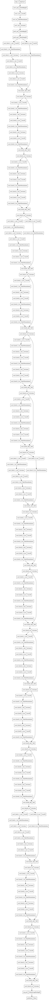

In [20]:
from keras.utils import plot_model
plot_model(model_1)

In [28]:
model_1.layers


sss
conv1_conv (1, 1, 64, 256)
64


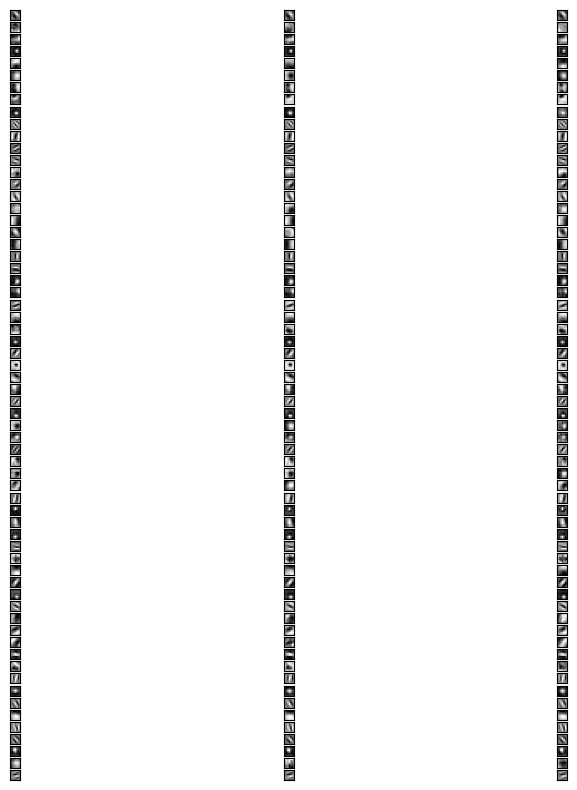

sss
conv2_block1_1_conv (7, 7, 3, 64)
64


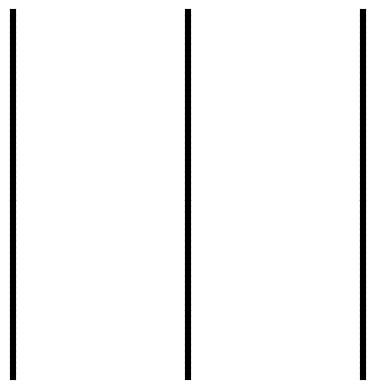

sss
conv2_block1_2_conv (1, 1, 64, 64)
64


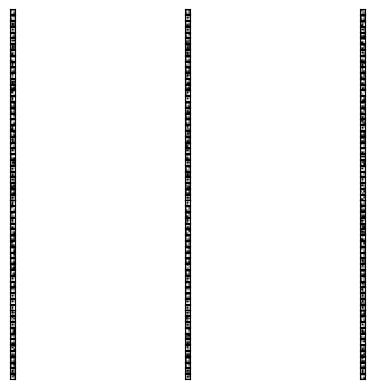

sss
conv2_block1_0_conv (3, 3, 64, 64)
256


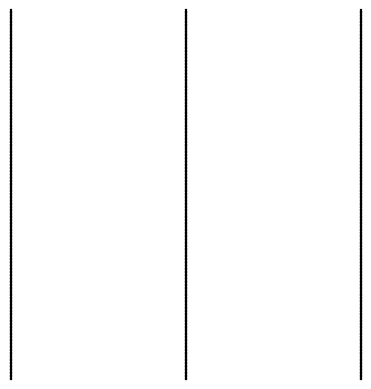

sss
conv2_block1_3_conv (1, 1, 64, 256)
256


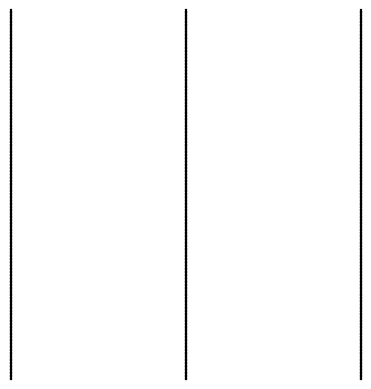

In [33]:
fig = pyplot.figure(figsize=(10,10))
import matplotlib.pyplot as plt
X=0
A=4
for layer in model_1.layers:
    if X >A:
      break;
    
    if len(layer.get_weights()) == 2:
        X+=1
        print("sss")
        weights, bias= layer.get_weights()
        print(layer.name, filters.shape)
        
        #normalize filter values between  0 and 1 for visualization
        f_min, f_max = weights.min(), weights.max()
        filters = (weights - f_min) / (f_max - f_min)  
        print(filters.shape[3])
        filter_cnt=1
        n_filters=filters.shape[3]
        ix=1
        for i in range(n_filters):
          # get the filter
          f = filters[:, :, :, i]
          # plot each channel separately
          
          for j in range(3):
            # specify subplot and turn of axis
            ax = pyplot.subplot(n_filters, 3, ix)
            ax.set_xticks([])
            ax.set_yticks([])
            # plot filter channel in grayscale
            pyplot.imshow(f[:, :, j], cmap='gray')
            ix += 1
        # show the figure
        pyplot.show()


1/1 [==============================] - 2s 2s/step
(1, 230, 230, 3)
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 112, 112, 64)


<ipython-input-37-e92feb90cb0b>:28: RuntimeWarning: invalid value encountered in true_divide
  x /= x.std ()


(1, 114, 114, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)


<ipython-input-37-e92feb90cb0b>:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure( figsize=(scale * n_features, scale) )


(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 14, 14, 256)
(1, 1

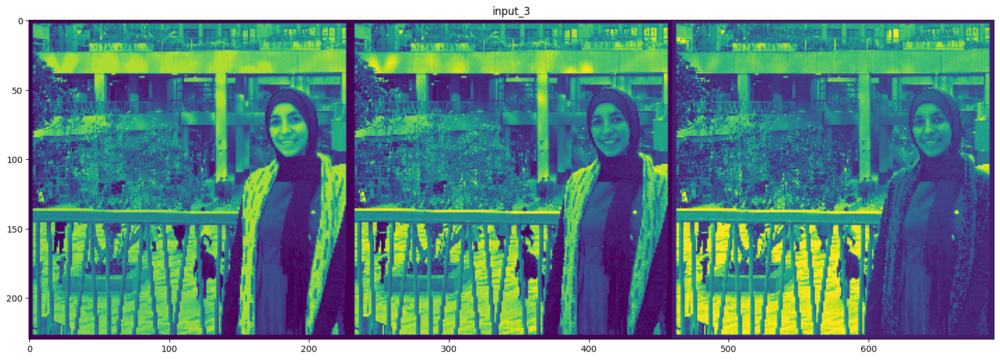

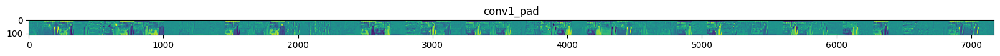

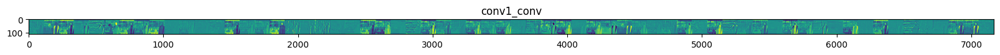

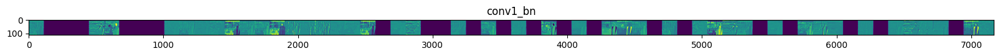

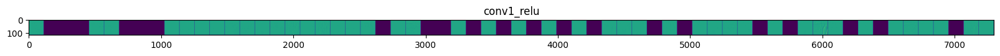

...

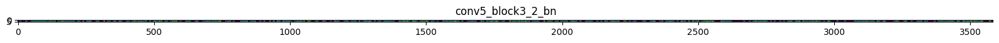

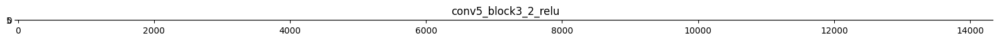

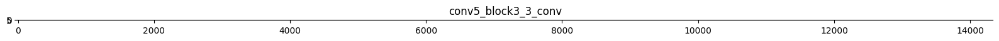

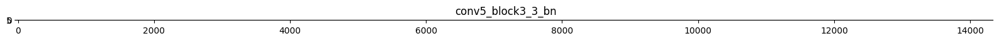

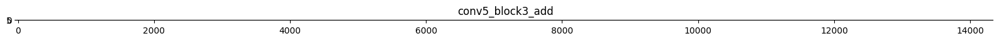

In [37]:
successive_outputs = [layer.output for layer in model_1.layers[1:]]
#visualization_model = Model(img_input, successive_outputs)
visualization_model =Model(inputs = model_1.input, outputs = successive_outputs)
# Convert ht image to Array of dimension (224,224,3)

x=img
# Let's run input image through our vislauization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)
# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model_1.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x
# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )


#FACENET

In [40]:
!pip install keras-facenet  

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 56.2 MB/s eta 0:00:00
  Created wheel for keras-facenet: filename=keras_facenet-0.3.2-py3-none-any.whl size=10370 sha256=052a6d4fe5da6d4e9f897d0b7b7c337561d8acdf01b6ecbdfb92efee34899e3b
  Stored in directory: /root/.cache/pip/wheels/1d/d8/a9/85cf04ea29321d2afcb82c0caaafdca9195385f9d68cbc7185
Successfully built keras-facenet


In [41]:
from keras_facenet import FaceNet

In [43]:
Embedder=FaceNet()
model_2=Embedder.model
model_2.summary()

Model: "inception_resnet_v1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 Conv2d_1a_3x3 (Conv2D)         (None, None, None,   864         ['input_5[0][0]']                
                                32)                                                               
                                                                                                  
 Conv2d_1a_3x3_BatchNorm (Batch  (None, None, None,   96         ['Conv2d_1a_3x3[0][0]']          
 Normalization)                 32)                                             

In [47]:
from keras.utils import plot_model
plot_model(model_2)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.997139 to fit



sss
conv1_conv (1, 1, 64, 256)
64


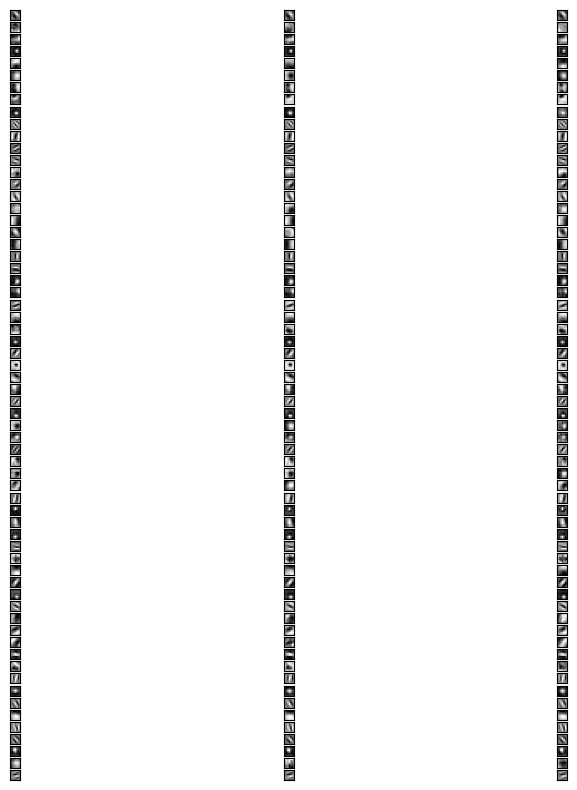

sss
conv2_block1_1_conv (7, 7, 3, 64)
64


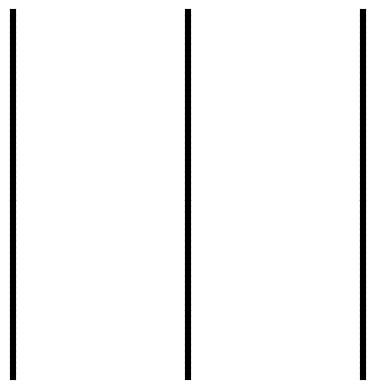

sss
conv2_block1_2_conv (1, 1, 64, 64)
64


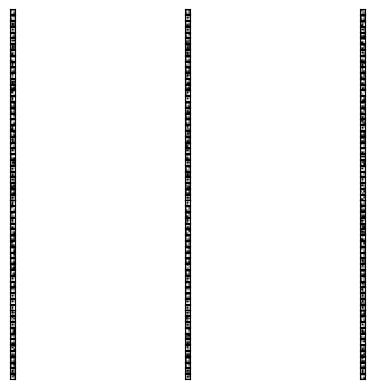

sss
conv2_block1_0_conv (3, 3, 64, 64)
256


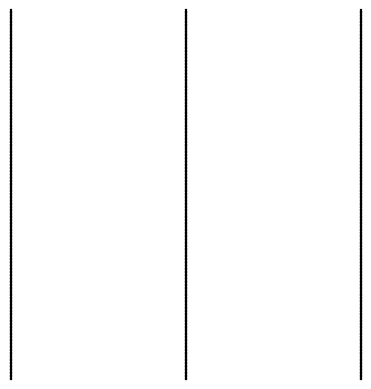

sss
conv2_block1_3_conv (1, 1, 64, 256)
256


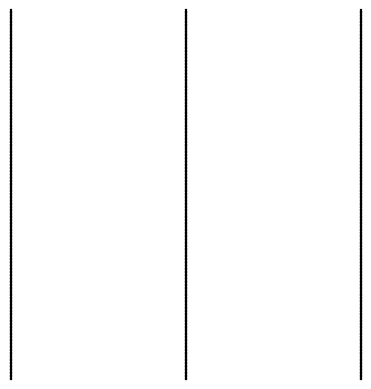

In [45]:
fig = pyplot.figure(figsize=(10,10))
import matplotlib.pyplot as plt
X=0
A=4
for layer in model_1.layers:
    if X >A:
      break;
    
    if len(layer.get_weights()) == 2:
        X+=1
        print("sss")
        weights, bias= layer.get_weights()
        print(layer.name, filters.shape)
        
        #normalize filter values between  0 and 1 for visualization
        f_min, f_max = weights.min(), weights.max()
        filters = (weights - f_min) / (f_max - f_min)  
        print(filters.shape[3])
        filter_cnt=1
        n_filters=filters.shape[3]
        ix=1
        for i in range(n_filters):
          # get the filter
          f = filters[:, :, :, i]
          # plot each channel separately
          
          for j in range(3):
            # specify subplot and turn of axis
            ax = pyplot.subplot(n_filters, 3, ix)
            ax.set_xticks([])
            ax.set_yticks([])
            # plot filter channel in grayscale
            pyplot.imshow(f[:, :, j], cmap='gray')
            ix += 1
        # show the figure
        pyplot.show()


1/1 [==============================] - 1s 1s/step
(1, 230, 230, 3)
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 114, 114, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)


<ipython-input-46-e92feb90cb0b>:28: RuntimeWarning: invalid value encountered in true_divide
  x /= x.std ()


(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)


<ipython-input-46-e92feb90cb0b>:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure( figsize=(scale * n_features, scale) )


(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 64)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 56, 56, 256)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 128)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 28, 28, 512)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1, 14, 14, 256)
(1,

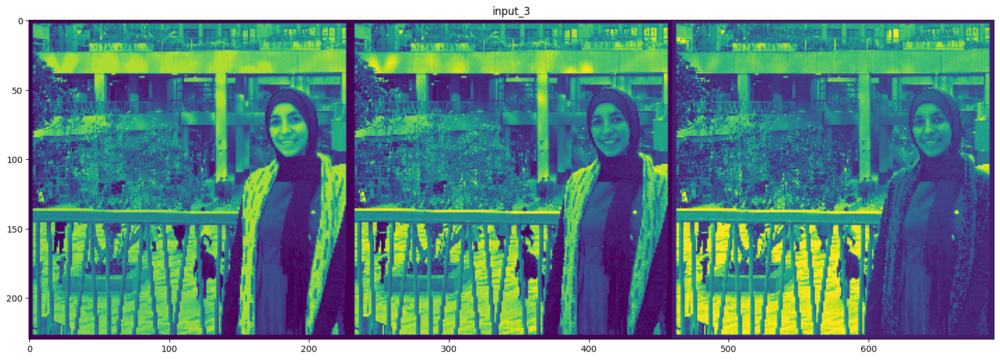

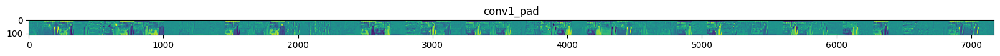

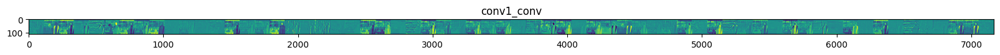

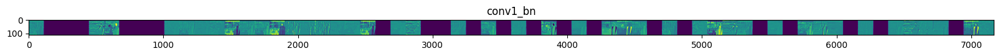

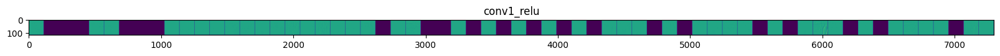

...

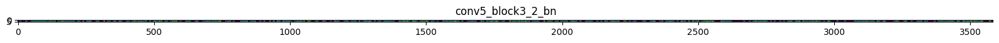

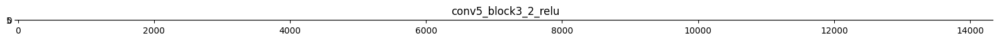

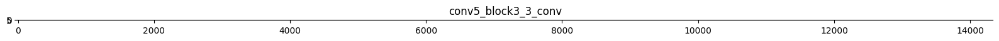

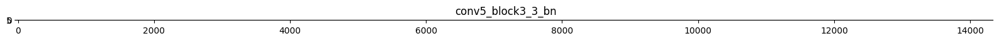

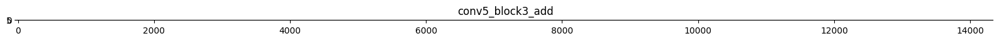

In [46]:
successive_outputs = [layer.output for layer in model_1.layers[1:]]
#visualization_model = Model(img_input, successive_outputs)
visualization_model =Model(inputs = model_1.input, outputs = successive_outputs)
# Convert ht image to Array of dimension (224,224,3)

x=img
# Let's run input image through our vislauization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)
# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model_1.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x
# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )


In [48]:
%pip install ultralytics
from ultralytics import YOLO 
import matplotlib.pyplot as plt
import cv2
import torch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 586.5/586.5 kB 22.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 205.1/205.1 kB 21.6 MB/s eta 0:00:00


# YOLO

In [50]:
%pip install ultralytics
from ultralytics import YOLO 
import matplotlib.pyplot as plt
import cv2
import torch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [52]:
model_3 = YOLO('yolov5mu.pt').model
print(model)

DetectionModel(
  (model): Sequential(
    (0): Conv(
      (conv): Conv2d(3, 48, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2), bias=False)
      (bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (1): Conv(
      (conv): Conv2d(48, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
      (act): SiLU(inplace=True)
    )
    (2): C3(
      (cv1): Conv(
        (conv): Conv2d(96, 48, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (cv2): Conv(
        (conv): Conv2d(96, 48, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
     

In [54]:
model_weights =[]
conv_layers = []
children_m = list(model_3.children())
count = 0
for i in range(len(children_m)):
    if type(children_m[i]) == nn.Conv2d:
        count+=1
        model_weights.append(children_m[i].weight)
        conv_layers.append(children_m[i])
    elif type(children_m[i]) == nn.Sequential:
        for j in range(len(children_m[i])):
            for child in children_m[i][j].children():
                if type(child) == nn.Conv2d:
                    count+=1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"convolution layers: {count}")
for i in range(len(conv_layers)):
  print(conv_layers[i],'\n')

convolution layers: 9
Conv2d(3, 48, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2), bias=False) 

Conv2d(48, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False) 

Conv2d(96, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False) 

Conv2d(192, 384, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False) 

Conv2d(384, 768, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False) 

Conv2d(768, 384, kernel_size=(1, 1), stride=(1, 1), bias=False) 

Conv2d(384, 192, kernel_size=(1, 1), stride=(1, 1), bias=False) 

Conv2d(192, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False) 

Conv2d(384, 384, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False) 



In [131]:
img=Image.open('/content/drive/MyDrive/IMAAA/img_dataset/Hajar Fawzi/Copy of Snapchat-1181011569.jpg')

In [132]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=0., std=1.)
])
img= transform(img)
img = img.unsqueeze(0)

In [126]:
img.shape

torch.Size([1, 3, 224, 224])

In [133]:
count

9

sss
torch.Size([6, 6, 3, 48])  ---  Conv2d(3, 48, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2), bias=False)
48


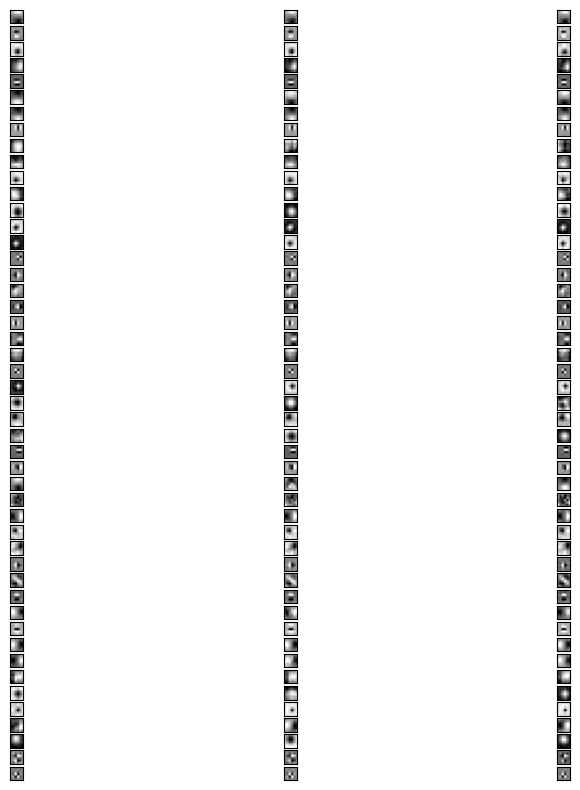

sss
torch.Size([3, 3, 48, 96])  ---  Conv2d(48, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
96


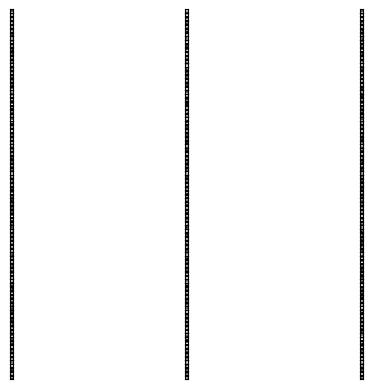

sss
torch.Size([3, 3, 96, 192])  ---  Conv2d(96, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
192


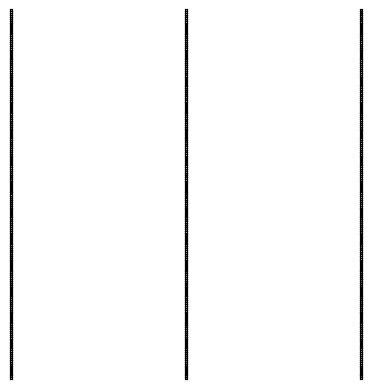

sss
torch.Size([3, 3, 192, 384])  ---  Conv2d(192, 384, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
384


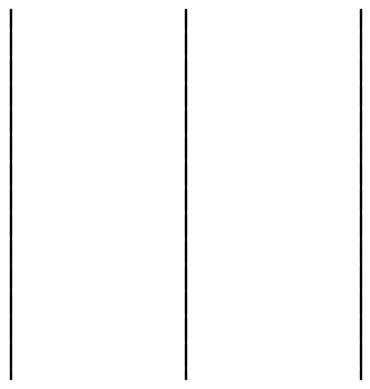

sss
torch.Size([3, 3, 384, 768])  ---  Conv2d(384, 768, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
768


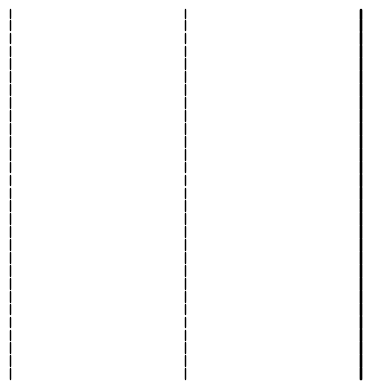

sss
torch.Size([1, 1, 768, 384])  ---  Conv2d(768, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)
384


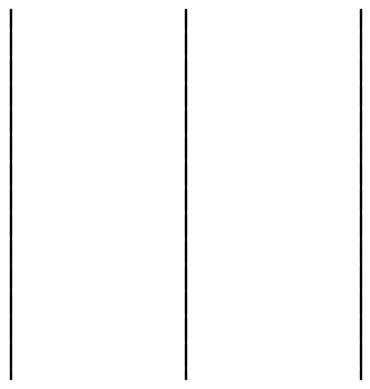

sss
torch.Size([1, 1, 384, 192])  ---  Conv2d(384, 192, kernel_size=(1, 1), stride=(1, 1), bias=False)
192


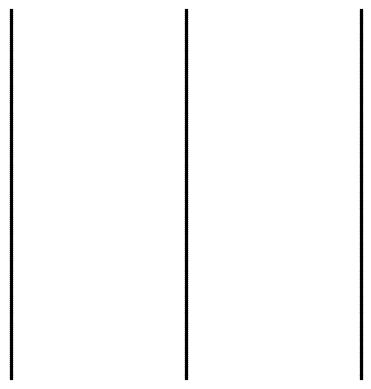

sss
torch.Size([3, 3, 192, 192])  ---  Conv2d(192, 192, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
192


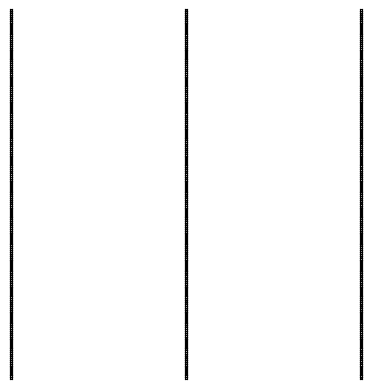

In [80]:
fig = pyplot.figure(figsize=(10,10))
import matplotlib.pyplot as plt

for layer in conv_layers[0:count-1]:
    
        print("sss")
        weights=torch.permute(layer.weight,(2,3,1,0))
        print(weights.shape, " --- ", layer)
        #print(layer.name, filters.shape)
        
        #normalize filter values between  0 and 1 for visualization
        f_min, f_max = weights.min(), weights.max()
        filters = (weights - f_min) / (f_max - f_min)  
        print(filters.shape[3])
        filter_cnt=1
        n_filters=filters.shape[3]
        ix=1
        for i in range(n_filters):
          # get the filter
          f = filters[:, :, :, i]
          # plot each channel separately
          
          for j in range(3):
            # specify subplot and turn of axis
            ax = pyplot.subplot(n_filters, 3, ix)
            ax.set_xticks([])
            ax.set_yticks([])
            # plot filter channel in grayscale
            pyplot.imshow(f[:, :, j], cmap='gray')
            ix += 1
        # show the figure
        pyplot.show()

In [128]:
for feature_map in successive_outputs:
    print(feature_map.shape)

torch.Size([1, 3, 224, 224])
torch.Size([48, 3, 6, 6])
torch.Size([1, 48, 112, 112])
torch.Size([96, 48, 3, 3])
torch.Size([1, 96, 56, 56])
torch.Size([192, 96, 3, 3])
torch.Size([1, 192, 28, 28])
torch.Size([384, 192, 3, 3])
torch.Size([1, 384, 14, 14])
torch.Size([768, 384, 3, 3])
torch.Size([1, 768, 7, 7])
torch.Size([384, 768, 1, 1])
torch.Size([1, 384, 7, 7])
torch.Size([192, 384, 1, 1])
torch.Size([1, 192, 7, 7])
torch.Size([192, 192, 3, 3])


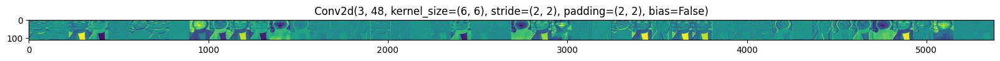

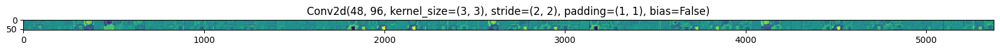

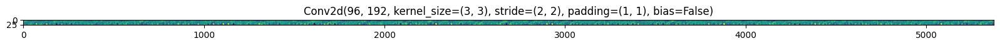

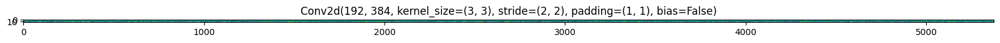

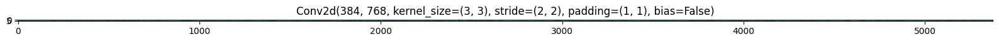

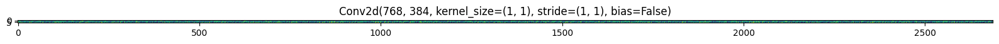

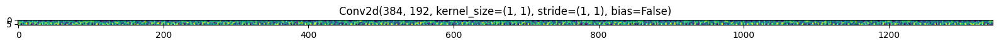

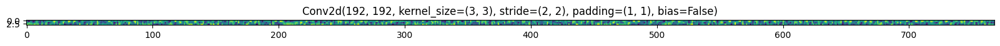

In [134]:
#successive_outputs = [layer.output for layer in model_1.layers[1:]]
#visualization_model = Model(img_input, successive_outputs)
#visualization_model =Model(inputs = model_1.input, outputs = successive_outputs)
# Convert ht image to Array of dimension (224,224,3)

#x=img
# Let's run input image through our vislauization network
# to obtain all intermediate representations for the image.
#successive_feature_maps = visualization_model.predict(x)
# Retrieve are the names of the layers, so can have them as part of our plot
successive_outputs = []
layer_names = []
for layer in conv_layers[0:8]:
    print(img.shape)
    img = layer(img)
    print(layer.weight.shape)
    successive_outputs.append(img)
    layer_names.append(str(layer))

for layer_name, feature_map in zip(layer_names, successive_outputs):
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
    feature_map=torch.permute(feature_map,(0,2,3,1))
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    # We will tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be visually palatable
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x=np.clip(x.numpy(), 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x
# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )